In [4]:
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.modeling import build_model
from detectron2.checkpoint import DetectionCheckpointer
from detectron2.projects.point_rend import add_pointrend_config
from detectron2.engine import default_argument_parser, default_setup

In [ ]:
model_zoo

In [26]:
cfg = get_cfg()
# add_pointrend_config(cfg)
# cfg.merge_from_file("config.yaml")
# cfg.freeze()

# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")


model = build_model(cfg)
DetectionCheckpointer(model, save_dir=cfg.OUTPUT_DIR).resume_or_load(
    cfg.MODEL.WEIGHTS, resume=True
)

model_final_f10217.pkl: 178MB [00:22, 8.01MB/s]                               


{'__author__': 'Detectron2 Model Zoo'}

In [27]:
import cv2
import torch

import detectron2.data.transforms as T

In [37]:
original_image = cv2.imread('images/微信图片_20220720202948.jpg', cv2.IMREAD_COLOR)

In [38]:
aug = T.ResizeShortestEdge(
            [cfg.INPUT.MIN_SIZE_TEST, cfg.INPUT.MIN_SIZE_TEST], cfg.INPUT.MAX_SIZE_TEST
        )

In [39]:
height, width = original_image.shape[:2]
image = aug.get_transform(original_image).apply_image(original_image)
image = torch.as_tensor(image.astype("float32").transpose(2, 0, 1))

inputs = {"image": image, "height": height, "width": width}

In [40]:
model.eval()

with torch.no_grad():
    # cv2.r
    out_data = model([inputs])[0]

In [41]:
v = Visualizer(original_image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(out_data["instances"].to("cpu"))

In [42]:
from PIL import Image

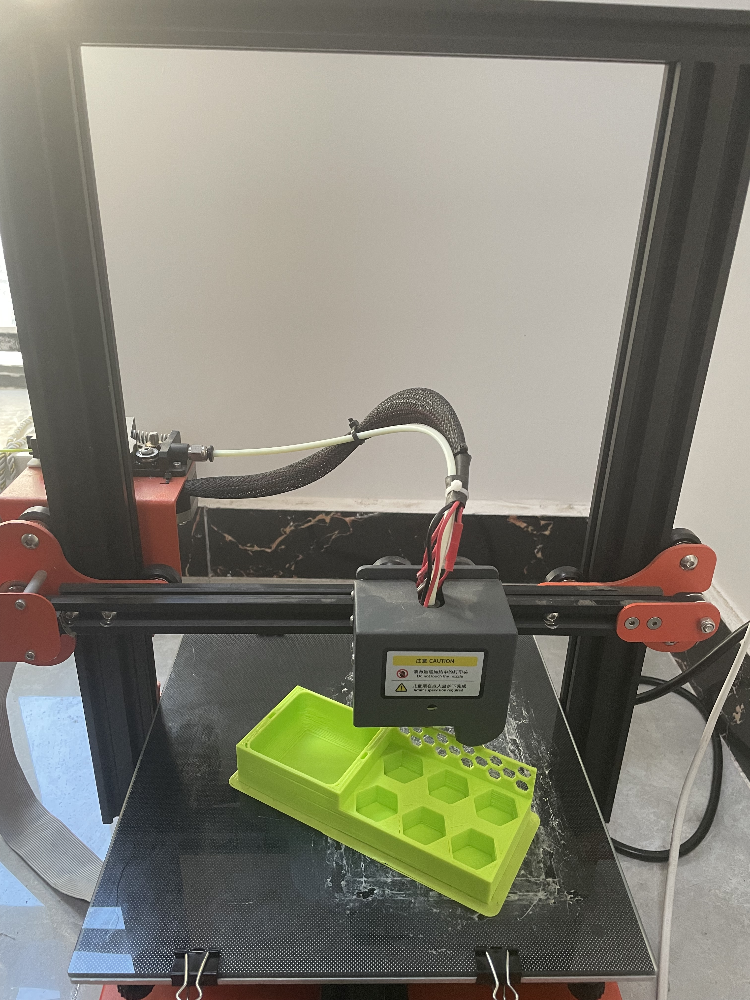

In [43]:
Image.fromarray(original_image[:, :, ::-1])

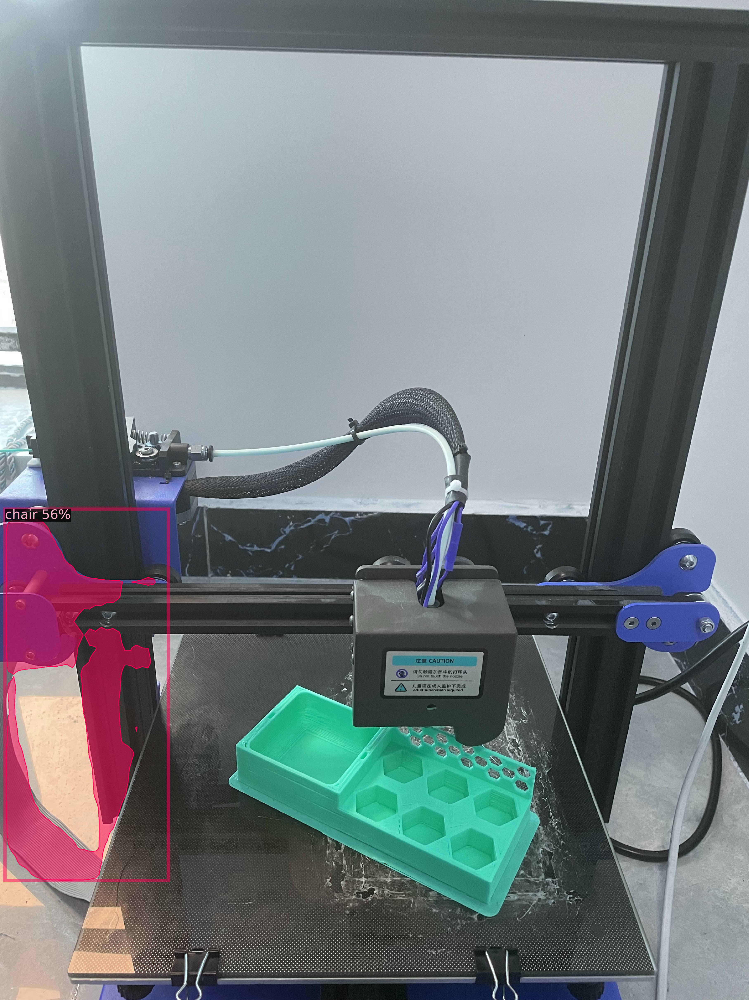

In [44]:
Image.fromarray(v.get_image()[:, :, ::-1])